$\newcommand{\bnabla}{\boldsymbol{\nabla}}$
$\newcommand{\eexp}[1]{\text{e}^{#1}}$
$\newcommand{\di}[0]{\text{d}}$
$\newcommand{\bs}[1]{\boldsymbol{#1}}$
$\newcommand{\ode}[2]{\frac{\di {#1}}{\di {#2}}}$
$\newcommand{\oden}[3]{\frac{\di^{#1} {#2}}{\di {#3}^{#1}}}$
$\newcommand{\odel}[2]{\di {#1}/\di {#2}}$
$\newcommand{\odeln}[3]{\di^{#1} {#2}/\di {#3}^{#1}}$
$\newcommand{\pde}[2]{\frac{\partial {#1}}{\partial {#2}}}$
$\newcommand{\pden}[3]{\frac{\partial^{#1} {#2}}{\partial {#3}^{#1}}}$
$\newcommand{\pdel}[2]{\partial_{#2} {#1}}$
$\newcommand{\pdenl}[3]{\partial^{#1}_{#3} {#2}}$
$\newcommand{\divr}[1]{\vec\nabla \cdot {#1}}$
$\newcommand{\divrb}[1]{\boldsymbol{\nabla} \cdot {#1}}$
$\newcommand{\grad}[1]{\vec \nabla {#1}}$
$\newcommand{\gradb}[1]{\boldsymbol\nabla {#1}}$
$\newcommand{\curl}[1]{\vec\nabla \times {#1}}$
$\newcommand{\curlb}[1]{\boldsymbol{\nabla}\times\boldsymbol{#1}}$
$\newcommand{\lapl}[0]{\vec\nabla^2}$
$\newcommand{\laplb}[0]{\boldsymbol{\nabla}^2}$
$\newcommand{\cplxi}[0]{\text{i}}$
$\newcommand{\unit}[1]{\mathbf{\hat{#1}}}$
$\newcommand{\thrfor}[0]{\quad\Rightarrow\quad}$
$\newcommand{\red}[1]{\textcolor{red}{#1}}$
$\newcommand{\blue}[1]{\textcolor{blue}{#1}}$
$\newcommand{\mage}[1]{\textcolor{magenta}{#1}}$
$\newcommand{\with}[0]{\quad\text{with}\quad}$
$\newcommand{\thrfor}[0]{\quad\Rightarrow\quad}$
$\newcommand{\andeq}[0]{\quad\text{and}\quad}$
$\newcommand{\oreq}[0]{\quad\text{or}\quad}$
$\newcommand{\stirling}[2]{\genfrac{[}{]}{0pt}{}{#1}{#2}}$

# Introduction

This lecture will delve deeper into what waves really do: they travel.
The previous lecture on standing waves provided a useful mathematical description that is widely used, but not always useful.
That's because these waves don't go anywhere, and waves are one of the main tools, Physics uses to move information around.
Most detection devices such as eyes or ears use waves that have travelled from wherever we look or hear towards, and so on.
As we will see, both points of views (standing vs. travelling) are two ways of looking at the same thing.

The demo for this lecture is tiny: it's just me, trying to whip the rubber hose to create a disturbance (with moderate success, I have to admit). See below (Jupyter), also at https://youtu.be/4uZecocmN3w or https://play.library.utoronto.ca/aef20263acb3529805746d6f63d6ed71.

In [1]:
from IPython.display import Image, display, YouTubeVideo, HTML
import numpy as np
import matplotlib.pyplot as plt
from matplotlib import interactive, rcParams, animation
from ipywidgets import interact, FloatSlider, fixed, IntSlider
interactive(True)
rcParams['figure.dpi'] = 100  # for crisper figures later

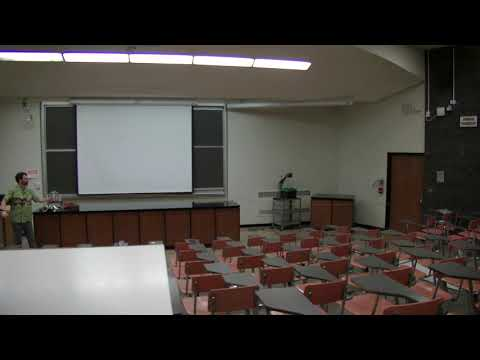

In [2]:
YouTubeVideo('4uZecocmN3w')

While there is no excuse for my poor handling of the rubber hose, there are a couple of good reasons why there are fewer and fewer videos: first, the concepts are increasingly common: we have all seen ripples in a puddle, or longer waves on larger bodies of water.
They are also increasingly abstract: the propagation of sound waves or light are everyday waves, and yet, their wavy features cannot easily be observed.
We will also study how waves propagate across discontinuities (say, two different pieces of strings), which is hard to easily observe because we need a type of wave that propagates slowly enough to be captured by the naked eye, and the physics department did not have that sort of device in store.

*Readings:*

* *French, Chap. 7 until page 243*

# Expectations

## Remember

* The wave equation $\pdenl2{y}t = v^2\pdenl2y{x}$,
* $y(x, t) = f(x - vt) + g(x+vt)$ is the general solution to the equation above.
* $v = \omega/k$ in priority; $v = \nu\lambda$ can be easily recovered from the previous equation, but it can be useful to remember is as such.
* When boundaries are a relevant concept, travelling waves can be decomposed as a sum of standing wave modes of the cavity.
* A standing wave mode can be interpreted as the superposition of two travelling waves of equal amplitude, equal frequencies and equal-and-opposite travelling speeds.
* The meaning and definition of the phase speed when multiple wave superpose.
* The meaning and definition of the group speed.
* That phase and group speeds are the same in a non-dispersive medium.
* The interpretation that when it can be defined, the group speed is the speed of propagation of the energy.

## Understand

* What it means for $y(x, t) = f(x - vt) + g(x+vt)$ to be the general solution to the wave equation. In particular, that it can be any shape when $v$ is constant.
* When $v$ depends on frequency or wave number, wave forms may evolve in time due to dispersion.
* $f(x-vt)$ is the part of the solution that travels towards $x>0$, $g(x+vt)$ the one that travels towards $x<0$. 

## Apply

* As usual, complete this list with worked examples, tutorials and problem sets.

# Travelling waves as superpositions of modes

Recall the video below, which I start here at the moment when I talk about travelling waves (also at https://youtu.be/Ki70ShYFtmA?t=193 and https://play.library.utoronto.ca/c4febe4cb2b4b0e8ee5641ffa524b24f?t=193): a chain of discrete oscillators can look like a standing wave, but also appears to  be able to support travelling waves.

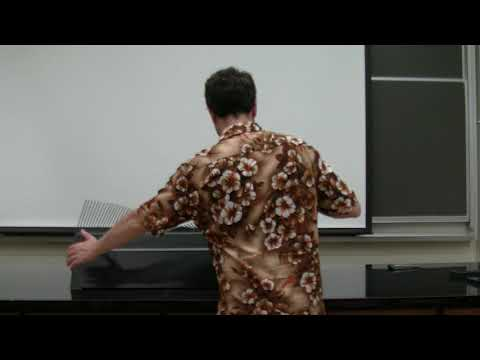

In [3]:
YouTubeVideo('Ki70ShYFtmA', start=193)

From earlier lectures, we know that the motion, whatever it is, can be decomposed as a sum of modes.
Yes, this decomposition seems awkward here, when I send disturbance pulses down the chain of oscillators.
Indeed, it feels like we could write the travelling motion as a more simple function that translates itself in space, with time.
In this section, I show that indeed, you could do both.

I will illustrate numerically here how the same code I used in the previous lecture to animate the plucked string can support travelling disturbances.
Recall that the code basically consisted of projecting an initial position onto modes, animating these modes in time, and summing them to obtain an approximate solution to the time evolution of the string.

I now do the same with and initial, gaussian-shaped perturbation:
$$ y(0, x) = d\exp\left[-\frac{(x-L/2)}{2\sigma_x^2}\right],$$
with $\sigma_x = L/20$ (see fig. 1).

I also set $\dot y(0, x) = 0$ (no initial velocity).
As a result, the initial bump does not have a propagation direction.
It splits into two bumps, with equal amplitudes of $1/2$ each and opposite travel directions.

In [4]:
L = .33  # length of string: 33 cm
F = 68  # tension in the string: 68 N
mu = 0.125/L  # mass per unit lenght of the string
ftsz = 13

x = np.linspace(0., L, 128)  # the x array
v = np.sqrt(F/mu)  # phase speed
k1 = np.pi/L  # the fundamental k; k_n = n*k0 and omega_n = n*v*k0

In [5]:
def plot_gaussian_string():
    xp = 0.1*L  # the point where the string is plugged
    sigma_x = 0.05*L
    x_bump = 0.5*L
    y_init = np.exp(-(x - x_bump)**2/(2*sigma_x**2))
    # y_init = x/xp  # the first part of the string; I will deivide all y's by d
    # y_init[x > xp] = (L - x[x > xp]) / (L - xp)  # the 2nd part

    fig = plt.figure()
    plt.plot(x/L, y_init, 'r')
    plt.xlabel('$x/L$', fontsize=ftsz)
    plt.ylabel('$y(0, x)/d$', fontsize=ftsz)
    plt.title('The string at $t=0$', fontsize=ftsz)
    plt.ylim([0., 1.1])
    plt.grid()
    plt.tight_layout()
    
    return x, y_init

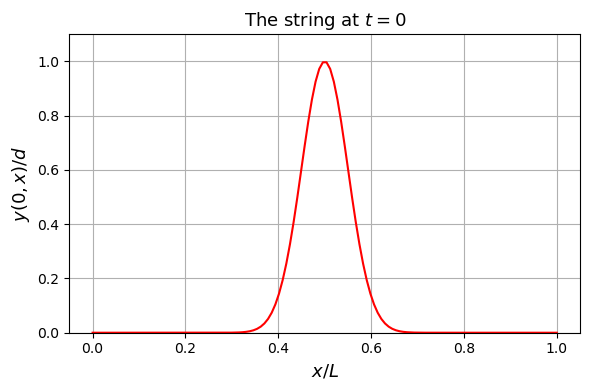

In [6]:
x, y_init = plot_gaussian_string()

In [7]:
def plot_gaussian_spectrum(N):

    k = [n*k1 for n in range(1, N+1)]  # the list of k's
    omega = [n*k1*v for n in range(1, N+1)]  # the list of omega's

    mode = {}  # all modes stored in a dictionary
    alpha = [0.]  # alpha coefficients stored in list
    y_approx = 0*x  # this will be the sum of thre first N modes

    # plotting the spectrum
    for n in range(1, N+1):
        # projection happens on line below!!!
        alpha.append(2. * np.trapz(y_init*np.sin(n*np.pi*x/L), x) / L)
        mode[n] = alpha[n] * np.sin(n*np.pi*x/L)
        y_approx += mode[n]

    plt.figure()
    for n in range(1, N+1):
        plt.plot([n]*2, [0., alpha[n]], 'o-', linewidth=5)
    plt.axis([0, N+0.5, 1.1*min(alpha), 1.1*max(alpha)])
    plt.axhline(0., color='k')
    plt.xlabel('Harmonic number $n$ ($\omega_n = n\pi v/L$)', fontsize=ftsz)
    plt.ylabel(r'Modal amplitude $\alpha_n/d$', fontsize=ftsz)
    plt.grid()
    plt.tight_layout()
    
    return omega, k, mode

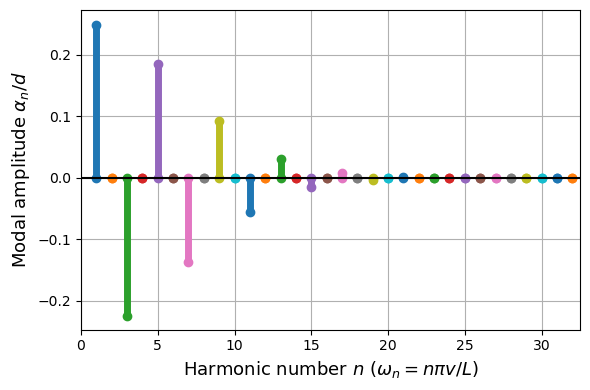

In [10]:
N = 32
omega, k, mode = plot_gaussian_spectrum(N)

We see on the spectrum of this initial condition (fig. 2) that the modal amplitudes $\alpha_n$ decay, but not as fast as before: we need more modes before reaching a satisfying approximation of the solution.
We will animate the solution, truncating it to its first 32 modes.

In [11]:
# Various quantities
imagelist = []  # list of frames to eventually animate

t_end = 2.*np.pi/omega[0]
n_frames = 100  # number of frames for animation
time = np.linspace(0., t_end, n_frames)  # time array

# Animation
fig = plt.figure(dpi=100)
ax = plt.gca()
ax.set_xlim([0., 1.])
ax.set_ylim([-1.1, 1.1])
ax.set_xlabel('$x/L$', fontsize=ftsz)
# ax.set_yticks(range(0, N+1))
# ax.set_yticklabels(['$tot$', '1', '2', '3', '4'])
ax.set_ylabel('$y(t, x)/d$', fontsize=ftsz)
ax.grid()

for t in time: # We loop over time to animate the modes
    y = 0*x  # nx positions for N modes
    for n in range(N):
        y += mode[n+1]*np.cos(omega[n]*t)

    im = plt.scatter(x/L, y, c='b')#c=y, cmap='copper')
    imagelist.append([im])
    
plt.tight_layout()
    
# Creation of the animation
ani = animation.ArtistAnimation(fig, imagelist, interval=60, blit=True, repeat_delay=80)
plt.close()

In [12]:
# Show the animation
HTML(ani.to_html5_video())

In [13]:
# Save the animation
ani.save('InitialBump.mp4')

(Animation saved under ```InitialBump.mp4```)
These are just a bunch of independent modes, doing their own things!

# Travelling solutions to the wave equation

Recall that the wave equation is
\begin{equation}
    \pden2{y}t = v^2\pden2y{x}.
    \label{eq:waveqn}
\end{equation}

## Decomposition into leftward and rightward-propagating waves

In this lecture, we will mostly ignore the existence of walls.
In this context, the variable separation technique, while still valid, does not provide much useful information.
Instead, I will show that the most general solution to the wave equation, is
\begin{equation}
    y(x, t) = f(x - vt) + g(x+vt). \label{eq:leftright}
\end{equation}

The beauty of this solution is that *any* function that can be written as $f(x-v t)$ or $g(x+vt)$, i.e., as a univarate function of $x-vt$ or $x+vt$, or a combination of both, is a solution of equation \eqref{eq:waveqn}.
But first, let me describe what it entails to be either $f(x-v t)$ or $g(x+vt)$.

Imagine your favourite function $f(x)$.
Now, picture $f(x-1)$: it is the same shape of the curve, but translated by one to the right.
Same for $f(x+1)$: it is the same, just translated to the left by one.
In either case, if I redefine the origin of $x$ to be one to the right or to the left, the curve will be back to its original position.

Now, picture $f(x-vt)$: you should be picturing the same curve, but translating progressively to the right with time, at a speed $v$.
For the $g(x+vt)$ case, you should be picturing a curve $g(x)$, translating to the left with speed $v$.
**The decomposition of any solution into** $\bs{f(x-v t)}$ **and** $\bs{g(x+vt)}$ **corresponds to a decomposition into right- and leftward propagating waves, respectively.**

The main travelling function we will encounter will be the travelling sinusoidal wave, as animated below (saved under `LeftAndRight.mp4`), and for which
\begin{align*}
    y(x, t) & = A\sin\left[\frac{2\pi}{\lambda}(x \pm vt)\right] \\
            & = A\sin\left[k(x \pm vt)\right] \\
            & = A\sin\left[\omega\left(\frac{x}{v} \pm t\right)\right] \\
            & = A\sin\left(kx \pm \omega t\right).
\end{align*}

We saw this before but let's but one more coin in the slot. 

* $\lambda$ is called the **wavelength** of the wave, which corresponds to the spatial period of the wave (the distance between two consecutive maxima or minima),
* $k$ is its **wavenumber**, 
* $\omega$ its **angular frequency** and
* $2\pi/\omega$ its **period** (the duration between two consecutive maxima or minima, at the same location).

The following relations will be useful:
$$\boxed{v = \frac{\omega}{k} = \lambda\nu}\andeq \boxed{\lambda = vT}.$$
Careful about the difference between $v$ ("vee", the velocity) and $\nu$ ("nu", the frequency). Also, the last $T$ refers to the period of the wave.

In [30]:
# Animation
fig = plt.figure()
ax = plt.gca()
ax.set_xlim([0., 1.])
ax.set_ylim([-1.1, 4.1])
ax.set_xlabel('$x/L$', fontsize=ftsz)
ax.set_yticks([0., 3.])
ax.set_yticklabels([r'$\sin(kx - \omega t)$', r'$\sin(kx + \omega t)$'],
                   fontsize=ftsz, rotation='vertical')
ax.grid()

imagelist = []

k = 4*np.pi/L

for t in time: # We loop over time to animate the modes
    y = 0*x  # nx positions for N modes
    f = np.sin(k*(x - v*t))
    g = np.sin(k*(x + v*t)) + 3

    y = np.vstack((f, g))
    x_scat = np.vstack((x, x))
    im = plt.scatter(x_scat/L, y, c=y, cmap='copper')
    imagelist.append([im])

# Create the animation
ani = animation.ArtistAnimation(fig, imagelist, interval=100, blit=True, repeat_delay=80)
plt.close()

In [31]:
# Show the animation
HTML(ani.to_html5_video())

In [32]:
# Save the animation
ani.save('LeftAndRight.mp4')

## Solutions to the wave equation

I now prove my early claim that equation \eqref{eq:leftright} is the general solution to the wave equation \eqref{eq:waveqn}.
In a first time, I will focus on $f(x-vt)$.

Let us change variables to $u = x-vt$, therefore, the only dependence of $f$ is on $u$: $f(u)$. Then,
$$ \pde{f}{x} = \pde{u}x\ode{f}u = \ode{f}u.$$

Likewise,
$$\pden2fx = \pde{u}x\oden2{f}u = \oden2{f}u.$$

For time, we have
$$\pde{f}t = \pde{u}t\ode{f}u = -v\ode{f}u \andeq \pden2{f}t = v^2\oden2{f}u,$$
and therefore,
$$\pden2{f}t = v^2\pden2{f}x.$$

A very similar succession of steps, with $u=x+vt$ this time, yields
$$\pden2{g}t = v^2\pden2{g}x.$$

Finally, for $y(x, t) = f(x-vt) + g(x+vt)$, linearity of the equations derived above implies that
$$\pden2{y}t = v^2\pden2{y}x.$$

This is true for *any* function, which can take the same form as equation \eqref{eq:leftright}.
We have not made any assumption about which functions were in $f$ and $g$: they can be sinusoidal travelling waves, they can be bumps, or anything else.
In fact, $y(x, t) = f(x-vt) + g(x+vt)$ is the most general solution to the wave equation.

## One standing wave as a superposition of two counter-propagating waves

Take one single standing wave on a string, attached to both ends:
$$y_n(t, x) = C_n\cos(\omega_n t)\sin(k_n x),$$
and recall that
$$\sin(a)\cos(b) = \frac12\left[\sin(a+b) + \sin(a-b)\right].$$

Therefore, 
\begin{align*}
y_n(x, t) & = \frac{C_n}{2}\left[\sin(k_n x + \omega_n t) + \sin(k_n x - \omega_n t)\right] \\
          & = \frac{C_n}{2}\left\{\sin [k_n(x + v t)] + \sin [k_n(x - v t)]\right\}.
\end{align*}
A standing wave mode can be interpreted as the superposition  of a leftward and a rightward wave!
**The standing and travelling wave representations are equivalent** (see animation saved under `LeftPlusRightEqualStanding.mp4`).

In [17]:
# Animation
fig = plt.figure()
ax = plt.gca()
ax.set_xlim([0., 1.])
ax.set_ylim([-2.1, 13.1])
ax.set_xlabel('$x/L$', fontsize=ftsz)
ax.set_yticks([0., 4., 8., 12.])
ax.set_yticklabels([r'$f + g$',
                    r'$f$ and $g$',
                    r'$g(x + v t)$',
                    r'$f(x - v t)$'],
                    fontsize=ftsz)
ax.grid()

imagelist = []

k = 4*np.pi/L

for t in time: # We loop over time to animate the modes
    y = 0*x  # nx positions for N modes
    # f and g were defined in the previous animation
    f = np.sin(k*(x - v*t))
    g = np.sin(k*(x + v*t))
    y = f + g

    y_scat = np.vstack((f+12, g+8, f+4, g+4, y))
    x_scat = np.vstack((x, x, x, x, x))
    im = plt.scatter(x_scat/L, y_scat, c=y_scat, cmap='copper')  #'b')
    plt.tight_layout()
    imagelist.append([im])

# Create the animation
ani = animation.ArtistAnimation(fig, imagelist, interval=100, blit=True, repeat_delay=80)
plt.close()

In [18]:
# Show the animation
HTML(ani.to_html5_video())

In [19]:
# Save the animation
ani.save('LeftPlusRightEqualStanding.mp4')

# Wave dispersion

## Introduction

Previously, we only considered cases, for which the phase speed $v$ does not depend on angular frequency $\omega$ or wavenumber $k$, because the ratio $\omega/k$ was always constant.
In general however, the phase speed depends on the frequency.
This has several implications, in particular when several wave modes are superposed.

Take the propagating bumps we used earlier in this lecture.
They were bouncing around on the string, and if the string had been infinitely long, they would have propagated for ever without changing shape.
Somehow, the interference pattern between all the wave modes that resulted in the bumps remained stable, all modes being able to "keep up" with the propagation of the bumps.

Now, if the string had been infinitely long, but all modes had a different phase speed, then after a while, the bumps would change shape.
They would break down, the fastest propagating modes leading the charge, and the slowest propagating modes trailing behind, increasingly so as time would go on.

This phenomenon is called **dispersion**.
The proper way to refer to it is to refer to *waves propagating in a dispersive medium*, although I may refer to *dispersive waves* to keep things short.
Some waves are virtually immune to it.
Examples are acoustic waves propagating in air (but propagation in other media can induce significant dispersion), surface water waves whose wavelengths are much longer than the fluid is deep, such as swell or tsunami, the waves on a taut string, and EM waves propagating in perfect vacuum.
These are merely results of approximations however, and the examples below are results for which the approximations hold very well.
In general, waves are subject to dispersion.

In particular, one of the most fundamental properties of waves in dispersive media is that energy and phase do not propagate at the same speed anymore.
In some cases, this leads to the definition of a so-called **group speed**, distinct from the phase speed, and which corresponds to the speed of propagation of the energy.

## Beating in non-dispersive media

Third time is the charm: we mentioned beating for two modes, oscillating in time only.
True beating happens when the amplitudes of the modes are equal to one another.
In this case, the position of mass $A$ is
$$x_A = \frac{q_1(t) + q_2(t)}2 = \frac{C \left[\cos(\omega_1 t) + \cos(\omega_2 t)\right]}2  = C\cos(\omega_0 t)\cos[(\Delta\omega) t],$$
with $\Delta\omega = (\omega_2 - \omega_1)/2$ and $\omega_0 = (\omega_1 + \omega_2)/2$.
Beating is most spectacular when $\Delta\omega \ll \omega_1$, in which case
$$x_A \approx C\cos(\omega_1 t)\cos[(\Delta\omega) t].$$
See figures below.

![](L02_FmaTools_38_0.png)
![](L02_FmaTools_38_1.png)

If now waves oscillate in time *and* space, beating happens again, but as a time-dependent process.
Let our two propagating waves of equal amplitudes be
$$\psi_1 = A \cos(k_1 x - \omega_1 t)\andeq \psi_2 = A \cos(k_2 x - \omega_2 t).$$
For now, we restrict our analysis to a non-dispersive medium, i.e., $\omega_1/k_1 = \omega_2/k_2 = v$ (the phase speed does not depend on frequency).

The superposition of the two waves yields
\begin{align*}
    \psi = \psi_1 + \psi_2 & = A\left[\cos(k_1 x - \omega_1 t) + \cos(k_2 x - \omega_2 t)\right] \\
                           & = 2A\left\{\cos[(\Delta k) x - (\Delta\omega) t] \cos\left[k_0 x - \omega_0 t \right]\right\}, \\
\end{align*}
with $\Delta k = (k_2 - k_1)/2$ and $\Delta \omega = (\omega_2 - \omega_1)/2$ the half-separations between wavenumbers and frequencies, respectively, and
$$\omega_0 = \omega_1 + \Delta \omega = \frac{\omega_1 + \omega_2}2 \andeq k_0 = k_1 + \Delta k = \frac{k_1 + k_2}2,$$
the average values of $\omega$ and $k$.

Again, beating is most spectacular when $\omega_1 \approx \omega_2$, or $\Delta\omega \ll \omega_1$, in which case the time intervals during which the two waves beat in phase to produce a strong signal are long.
See display below for the wave along $x$, animated over time (saved under `BeatingNonDisp.mp4`).

In [20]:
# basic quantities
omega1 = 2*np.pi*265  # 265 Hz is the frequency of our turning fork
omega2 = 2*np.pi*285  # 265 Hz is the frequency of our turning fork
v = 340.  # 340 m/s is the approximate speed of sound in air
ftsz = 13  # font size on plots
A = 1.  # Why not?
nBeats = 4.  # duration, long enough to hear nBeat beats 
nBeats_x = 1.5  # distance, long enough to see nBeat_x beats

# derived quantities
k1 = omega1/v
k2 = omega2/v

Domega = 0.5*(omega2 - omega1)
Dk = 0.5*(k2 - k1)

t_end = nBeats*np.pi/Domega
x_end = nBeats_x*np.pi/Dk

time = np.linspace(0., t_end, 2**10)
# x = np.linspace(0., x_end, 512)

In [21]:
x = np.linspace(0., x_end, 512)
plotcols = ["blue", "green", "blue", "green", "red", "red", "red"]

fig = plt.figure(figsize=(7, 6), dpi=100)
ax = plt.axes(xlim=(0., x_end), ylim=(-2.2, 9.7))
ax.set_xlabel('$x$ [m]')
ax.set_yticks([0., 3.5, 6., 8.5])
ax.set_yticklabels([r'$\psi_1 + \psi_2$',
                    r'$\psi_1$, $\psi_2$',
                    r'$\psi_2(x, t)$', r'$\psi_1(x,t)$'],
                   fontsize=ftsz)
ax.grid()

list_of_lines = []
for index, _ in enumerate(plotcols):
    if index < 5:
        lobj = ax.plot([], [], lw=1, color=plotcols[index])[0]
    else:
        lobj = ax.plot([], [], lw=1, color=plotcols[index], linestyle=':')[0]
    list_of_lines.append(lobj)

def init():
    for line in list_of_lines:
        line.set_data([], [])
    return list_of_lines

def animate(i):
    psi1 = A*np.cos(k1*x - omega1*time[i])
    psi2 = A*np.cos(k2*x - omega2*time[i])
    psi = psi1 + psi2
    envelope = 2*A*np.cos(Dk*x - Domega*time[i])
    list_of_lines[0].set_data(x, psi1+8.5)
    list_of_lines[1].set_data(x, psi2+6.)
    list_of_lines[2].set_data(x, psi1+3.5)
    list_of_lines[3].set_data(x, psi2+3.5)
    list_of_lines[4].set_data(x, psi)
    list_of_lines[5].set_data(x, envelope)
    list_of_lines[6].set_data(x, -envelope)
    return list_of_lines

ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=len(time), interval=80, blit=True)
plt.tight_layout()
plt.close()

In [22]:
# Show the animation
HTML(ani.to_html5_video())

In [23]:
# Save the animation
ani.save('BeatingNonDisp.mp4')

## Phase speed, group speed

What if now the phase speed $v$ depended on the frequency or wavenumber of the wave?
A medium in which such a phenomenon happens is called **dispersive**, and it is in fact the most general case.
In this case, $$\frac{\omega}k = v(\omega)\oreq v(k),$$
and the general relation between $\omega$ and $k$,
$$\omega = v(k)k,$$
is called a **dispersion relation**, and it is a property of the physical characteristics of the medium.

In this section, I do not have to assume that $\Delta \omega \ll \omega_1$. Let me reboot the previous derivation about beating, this time with
$$\psi_1 = A \cos(k_1 x - \omega_1 t)\andeq \psi_2 = A \cos(k_2 x - \omega_2 t).$$
I will drop the assumption that $v$ is constant later on.
We had found that
$$\psi = \psi_1 + \psi_2 = 2A\cos[(\Delta k) x - (\Delta\omega) t] \cos\left[k_0 x - \omega_0 t \right].$$

Therefore,
$$\psi = E(x, t)\cos\left[k_0 x - \omega_0 t \right], \quad\textrm{with}\quad E(x, t) = 2A \cos[(\Delta k) x - (\Delta\omega) t].$$

Written as above, the expression is that of a wave of phase speed
$$\boxed{v = \frac{\omega_0}{k_0}},$$
modulated in time and space by the envelope $E(x, t)$.
Notice that I framed the expression, as if it were a new one. 
It does look like one we saw before, but this is evaluated at the mean angular frequency and mean wavenumber, which didn't make sense when there was just one angular frequency.

Of course, just like beating, this representation works best if the modulation happens slowly in time, i.e., $\Delta \omega \ll \omega_0$.
That's just because if the modulation is slow, it feels more comfortable to think of it as a wave that propagates and evolves slowly.
But it can be written as the equation above in any case.

In [25]:
# basic quantities
omega1 = 2*np.pi*265  # 265 Hz is the frequency of our turning fork
omega2 = 2*np.pi*285  # 265 Hz is the frequency of our turning fork
v = 340.  # 340 m/s is the approximate speed of sound in air
v1 = 360.  # speed of sound in air for omega1
v2 = 320.  # speed of sound in air for omega2
# note: sound waves in air are virtually non-dispersive!
# These values are unrealistic for sound waves, but good for an example.
ftsz = 13  # font size on plots
A = 1.  # Why not?
nBeats = 2.  # duration, long enough to hear nBeat beats 
nBeats_x = 2.5  # distance, long enough to see nBeat_x beats

# derived quantities
k1 = omega1/v1
k2 = omega2/v2

k0 = 0.5*(k1 + k2)
omega0 = 0.5*(omega1 + omega2)

Domega = 0.5*(omega2 - omega1)
Dk = 0.5*(k2 - k1)

t_end = nBeats*np.pi/Domega
x_end = nBeats_x*np.pi/Dk

time = np.linspace(0., t_end, 2**10)
# x = np.linspace(0., x_end, 512)

In [26]:
x = np.linspace(0., x_end, 256)
plotcols = ["blue", "green", "blue", "green", "red", "red", "red"]

fig = plt.figure(figsize=(7, 6), dpi=100)
ax = plt.axes(xlim=(0., x_end), ylim=(-2.2, 9.7))
ax.set_yticks([0., 3.5, 6., 8.5])
ax.set_yticklabels([r'$\psi_1 + \psi_2 $',
                    r'$\psi_1$, $\psi_2$',
                    r'$\psi_2(x, t)$', r'$\psi_1(x, t)$'],
                   fontsize=ftsz)
ax.set_xlabel('$x$ [m]', fontsize=ftsz)
ax.grid()

plt.tight_layout()

list_of_lines = []
for index, _ in enumerate(plotcols):
    if index < 5:
        lobj = ax.plot([], [], lw=1, color=plotcols[index])[0]
    else:
        lobj = ax.plot([], [], lw=1, color=plotcols[index], linestyle=':')[0]
    list_of_lines.append(lobj)

def init():
    for line in list_of_lines:
        line.set_data([], [])
    return list_of_lines

def animate(i):
    psi1 = A*np.cos(k1*x - omega1*time[i])
    psi2 = A*np.cos(k2*x - omega2*time[i])
    psi = psi1 + psi2
    envelope = 2*A*np.cos(Dk*x - Domega*time[i])
    list_of_lines[0].set_data(x, psi1+8.5)
    list_of_lines[1].set_data(x, psi2+6.)
    list_of_lines[2].set_data(x, psi1+3.5)
    list_of_lines[3].set_data(x, psi2+3.5)
    list_of_lines[4].set_data(x, psi)
    list_of_lines[5].set_data(x, envelope)
    list_of_lines[6].set_data(x, -envelope)
    return list_of_lines

ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=len(time), interval=80, blit=True)
plt.close()

In [27]:
# Show the animation
HTML(ani.to_html5_video())

In [28]:
# Save the animation
ani.save('BeatingDisp.mp4')

As you can see in the animation above (saved under `BeatingDisp.mp4`), when the two waves travel at different velocities, the pattern at each instant is still that of beating.
But the difference is that is the waves travel at different speeds, they "slide by each other", and the pattern of beating moves, i.e., the envelope, propagates at a different speed than the wave inside it.

*Note: This is a delicate point, which falls under the category of "Understanding came quickly, but only after a lengthy explanation". I encourage you stare at the two beating animations I provided to convince yourself, but it may not be suitable for everyone. Therefore, I also encourage you to seek alternative references: other textbooks, movies on the web, or else.*

How fast does the envelope travel?
The envelope is
$$E(x, t) = 2A\cos[(\Delta k)x - (\Delta \omega)t] = 2A\cos\left[\Delta k\left(x - \frac{\Delta \omega}{\Delta k}t\right)\right].$$
This would be the expression of a wave, propagating with a phase speed $\Delta\omega/\Delta k$.
The envelope is not a wave, but this expression still tells us that it travels with velocity $\Delta \omega/\Delta k$.

The velocity of the envelope is called the **group velocity**.
In this case, it is defined as
$$v_g = \frac{\Delta \omega}{\Delta k} = \frac{\omega_2 - \omega_1}{k_2 - k_1}.$$

In this particular case, there are only two frequencies.
But in practice, the notion of group speed is only used when there are a bunch of different waves of different frequencies and different wavelengths that are all close together.
In this example with only two frequencies, let us compute the approximate value of $v_g$ when assuming that it is the case, i.e., that $\Delta \omega \ll \omega_0$ or $\Delta k \ll k_0$.
The Taylor series expansion of $\omega_0(k_0 \pm \Delta k)$ is
$$\omega(k_0\pm \Delta k) = \omega(k_0) \pm \Delta k\left.\ode{\omega}{k}\right|_{k=k_0} + O(\Delta k^2).$$

Therefore,
$$\omega_2 - \omega_1 \approx 2\Delta k\left.\ode{\omega}{k}\right|_{k=k_0} = (k_2 - k_1)\left.\ode{\omega}{k}\right|_{k=k_0},$$
or,
$$\Delta k\to 0 \quad \Rightarrow\quad\frac{\omega_2 - \omega_1}{k_2 - k_1} = \boxed{v_g(k_0) = \left.\ode{\omega}{k}\right|_{k=k_0}}.$$
**The group velocity is the $\bs k$-derivative of $\bs{\omega(k)}$ evaluated at the *mean* wavenumber.**

One important remark about the result above.
While $v_g = \odel{\omega}k$ is the actual definition of the group speed, the calculation above was not a derivation.
It was merely an illustration of a continuous process with discrete waves, and in the context of that particular case, is only truly true when $\Delta k \to 0$.
Natural superpositions of waves are usually made of a continuous superposition of waves of slightly different $k$'s.
Because the $k$'s exist on a continuum, $\Delta k \to 0$ actually becomes a valid limit.
I will not cover this case, because the mathematical tools necessary to properly treat it are related to Fourier transforms, which is beyond the scope of this class.

**So, remember this: the calculation above is an illustration, not a derivation. Nonetheless, the true definition of the group speed is** $\bs{v_g = \odel{\omega}k}$.

We now have two wave speeds: the phase speed and the group speed.
In our 1D case, to go from one to the other is relatively easy, because
$$v_g = \ode{\omega}k = \ode{(kv)}k = v + k\ode{v}k,$$
where everything is evaluated at $k=k_0$.
In a non-dispersive medium where $v$ is constant no matter $\omega$ or $k$, therefore, $\odel{v}k = 0$ and
$$\boxed{v_g = v\ \textrm{in a non-dispersive medium}}.$$

It might be easier at this early stage to think in terms of wavelength $\lambda$, rather than wavenumber $k$.
The change of variable $k = 2\pi/\lambda$ yields
$$\ode{v}k = \ode{\lambda}k\ode{v}\lambda = -\frac{2\pi}{k^2}\ode{v}\lambda = -\frac{\lambda^2}{2\pi}\ode{v}\lambda,\andeq \boxed{v_g = v - \lambda\ode{v}\lambda},$$
where again everything is evaluated at $\lambda = \lambda_0$.

## Dispersion  Relation

### Definition

As it turns out, and for reasons that we will touch upon with EM waves in an ionized gas, in most natural situations and non-dispersive media, $\odel{v}\lambda > 0$ and therefore, $v_g < v$ (just like in the last animation, `BeatingDisp.mp4`).
This is called *normal dispersion*.
The $\odel{v}\lambda < 0$, $v_g > v$ is not impossible, but it is less frequently encountered.
We talk about *anomalous dispersion*.
It may sound harsh and stigmatizing for the poor $v_g > v$ case, but again, we will see later why there sometimes are physical reasons to think so.

The relation linking $\omega$ with $k$ is called the **dispersion relation** of a type of waves in a given medium.
Alternatively, and equivalently, expressions for e.g. $\omega^2(k)$, $v(k)$, $v^2(k)$ can also be called dispersion relations, because $\omega = kv$ and there is no loss of information in going from one to the other.

See sketch below: the three curves (a), (b) and (c) represent three types of dispersion. Curve (a) represents non-dispersive behaviour because at every point, $\omega/k=\odel\omega{k}$. Curve (c) is called normal: the line from the origin to $P$ has slope $\omega/k$, and it is larger than the slope $\odel\omega{k}$ at $P$. Curve (b) represents anomalous dispersion.

![](DispRel.png)

### Example: EM waves in an ionized gas

The ionosphere is the layer of the atmosphere of a planet where the gas is very rarefied, and UV rays of the sun partially ionize the molecules.
On Earth, it is found from 60-100 km high, up to 800 km (*Note: the ISS orbits at about 400 km altitude*).
This ionized gas again interacts with EM waves, and in particular with radio waves.
The dispersion relation for radio waves in the ionosphere becomes
$$\omega^2(k) = \omega_p^2 + c^2 k^2\quad\text{for}\quad \omega>\omega_p,$$
where $c$ is the phase speed of EM waves in vacuum (the "speed of light") and $\omega_p$ is called the plasma oscillation frequency.
The latter is the natural frequency of oscillation of a cloud of negative oscillating around a cloud of positive charges, which is what an ionized gas consists of.
The frequency value is typically $\omega_p/(2\pi) = \nu_p \approx 40$ MHz.
Waves whose frequency is lower than $\omega_p^2$ simply cannot propagate into the ionosphere.

This is why long-distance radio transmission works: by bouncing off the ionosphere, radio waves stick to the ground and can duct along it over long distances.
This includes high-frequency ($1.6$ MHz$< \nu < 30$ MHz) radio waves used by radio amateurs, and AM waves ($575 - 1705$ kHz).

On the other hand, FM waves have a minimum frequency that is $87.5$ MHz, which is higher than the plasma frequency.
Therefore, they don't travel farther than the visible horizon, and escape to the ionosphere and then to space after that.
This is why FM signals don't travel much farther than about 60 km, and why transmitters have to be placed high up on towers or hills.

The phase speed of radio waves, propagating into the ionosphere, is
$$v = \frac{\omega}k = \sqrt{\frac{\omega_p^2}{k^2} + c^2} = c\sqrt{\frac{c^2k^2 + \omega_p^2}{c^2 k^2}} = \frac{c}{\sqrt\frac{c^2k^2 + \omega_p^2 - \omega_p^2}{\omega^2_p + c^2k^2}} = \frac{c}{\sqrt{1 - \omega_p^2/\omega^2}}.$$

Looking at $v$, you may notice that if this expression is only relevant for $\omega > \omega_p$, then $v>c$!!!
However, the famous statement that nothing can travel faster than the speed of light only applies to what I am going to call "stuff", i.e., matter, energy, information...
A phase is not "stuff" in itself, just a pattern that moves.
When light hits Earth from the far reaches of space, it has traveled in the form of pulses, i.e., light waves that have traveled, bundled within envelopes.
Evelopes travel at the *group velocity*, not the phase velocity, and according to the equation I am about to derive, $v_g = c^2/v < c$.

Indeed, we could compute the group speed easily by taking the $k$-derivative of the dispersion relation $\omega^2 = \omega_p^2 + c^2 k^2$.
A shrewder way to do the same thing is to take the differential form of that equation, i.e.,
$$2\omega\di \omega = 2c^2 k \di k\thrfor v_g = \ode{\omega}k = \frac{c^2 k}{\omega} = c\sqrt{1 - \omega_p^2/\omega^2}.$$

Which brings me to my next point: the fundamentally important interpretation of the group speed is that **the group speed is the speed of propagation of the energy**.
Think of those light pulses: they are the ones that carry the energy that will impact light detectors, and if the group speed is their velocity, then so is the velocity of propagation of energy.

## Collapse of a Gaussian wave packet

I mentioned earlier that with dispersion, disturbances lose their shape over time. Let me illustrate this behaviour on an example: the Gaussian wave packet.

To illustrate it, I chose the example of deep-water capillary-gravity waves. "Gravity waves" mean that the restoring force is gravity, a big lump (typically more than a few cm in wavelength) of water tending to fall due the gravity. "Capillary waves" mean that the restoring force is now due to surface tension: nature hates interfaces, and surface tension is the mechanism by which tiny ripples (less than 1 cm in wavelength for the air/water interface) get flatten out.
The dispersion relation is
$$\omega^2 = gk + \frac{\sigma k^3}\rho,$$
where $g$ is the acceleration due to gravity, $\sigma$ is the surface tension of the air/water interface, and $\rho$ is the mass density of water, respectively.
In the code below, I chose a wavelength of 1 mm, meaning that the second term on the RHS dominates over the first term, and the dispersion is anomalous (you can check).

I initialize a "wave packet".
Wave packets are a superposition of waves with a dominant wave with wavenumber $k_0$, superposed with waves, whose amplitude decays as $|k-k_0|$ increases.
For example, I plot in the figure below an example with
$$a_n = \exp\left(-\left(\frac{k_n-k_0}{\Delta k}\right)^2\right),$$
with $\Delta k$ controlling the width of the function $a(k)$.
Wave packets are well-localized in space and time.
The energy is concentrated in them, another illustration that **the group speed is the speed of propagation of the energy**.

Let's just animate all of these waves and see what happens to our wave packet...

In [59]:
# Basic quantities; let's use capillary waves
lambda0 = 1e-3  # 1 mm for a wavelength
k0 = 2*np.pi/lambda0

dk = k0/20  # wavenumber separation of successive wavenumbers
N = 19  # number of waves
nBeats_x = 1.2  # distance, long enough to see nBeat_x beats

# derived quantities
k_array = np.arange(k0-0.5*dk*(N-1), k0+0.5*dk*N, dk)
A_array = A*np.exp(-(k_array-k0)**2/(3*dk)**2)  # all waves have same amplitude
x_end = nBeats_x*np.pi/dk
x = np.linspace(-x_end, x_end, 1024)

psi_n = {}  # each individual wave is an item in a dictionnary
psi = 0*x + 0*1j
for ii, kk in enumerate(k_array):
    psi_n[ii] = A_array[ii]*np.exp(1j*kk*x)  # I will take the real part
    psi += psi_n[ii]

yMin, yMax = -N-1., N+1.

In [60]:
# code for the spectrum
def plot_gaussian_wavepacket():
    plt.figure()
    for ii in range(N):
        plt.plot([k_array[ii]]*2, [0., A_array[ii]], 'o-', linewidth=5)
    plt.grid()
    plt.ylabel('Plane wave amplitude [m]', fontsize=ftsz)
    plt.xlabel('$k$', fontsize=ftsz)

    plt.tight_layout()

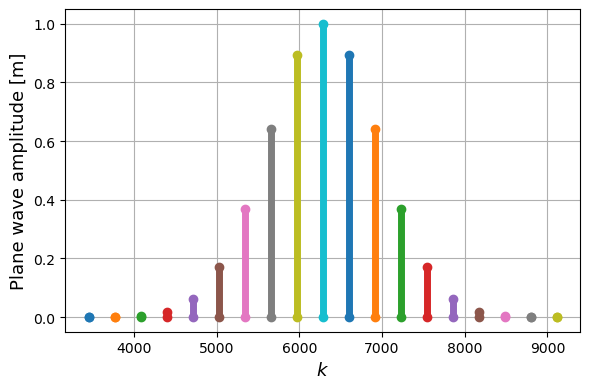

In [61]:
plot_gaussian_wavepacket()

In [62]:
# code for the animation
def omega(k_):  # dispersion relation
    return np.sqrt(g*k_ + sigma*k_**3/rho)  # dispersion relation for deep-water waves

sigma = 7.2e-2  # surface tension of air/water interface [N/m^2]
g = 9.81  # gravitational acceleration [m/s^2]
rho = 1000.  # mass density of water [kg/m^3]
 
nBeats = 8.
t_end = nBeats*np.pi/(omega(k0+dk) - omega(k0))
time = np.linspace(0., t_end, 1024)

fig = plt.figure(dpi=100) 
ax = plt.axes(xlim=(-x_end, x_end), ylim=(-10., 10.))
ax.set_xlabel('$x$ [m]', fontsize=ftsz)

ax.grid()

list_of_lines = [ax.plot([], [], lw=1)[0]]

def init():
    for line in list_of_lines:
        line.set_data([], [])
    return list_of_lines

def animate(i):
    psi = 0*x + 0*1j
    for ii in range(0, N):  # each individual psi_n
        phase_t = omega(k_array[ii])*time[i]
        psi += psi_n[ii]*np.exp(-1j*phase_t)
    ax.set_title('$t = {0: 3.0f}$ ms'.format(1000*time[i]))
    list_of_lines[0].set_data(x, np.real(psi))

    return list_of_lines

ani = animation.FuncAnimation(fig, animate, init_func=init,
                              frames=len(time), interval=40, blit=True)

plt.close()

In [63]:
# Show the animation
HTML(ani.to_html5_video())

In [58]:
# Save the animation
ani.save('BeatingDisp.mp4')

# Summary

In this lecture, we saw:

* The equivalence of standing and travelling wave representations.
    * Like all solutions of the wave equation a BCs, travelling waves are a superposition of standing wave modes.
    * One standing wave mode is the superposition of two equal-and-counter-propagating sine waves.
* To be a solution to the non-dispersive wave equation, you only have to travel at the right speed. It doesn't matter what function describes you, as long as it translates in space at the right speed.
* Wave dispersion happens when the propagation velocity is not constant anymore, but depends on $k$, $\omega$ or equivalent.
* Phase speed is the speed of propagation of the pattern "phase". Group speed is the speed of propagation of the envelopes, where energy is concentrated. Therefore, it is often assimilated with the speed of propagation of energy.
* The three types of dispersion: non-dispersive ($v= v_g$), normal ($v > v_g$) and anomalous ($v<v_g$).

And a bonus, in the video, one of the landmark experiments of physical oceanography: the Waves Across the Pacific (WAP) experiment. Walter Munk left us in 2019 at the age of 

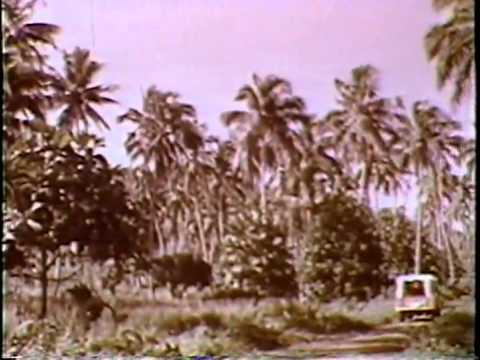

In [29]:
YouTubeVideo("MX5cKoOm6Pk")